# Global Indices Data Ingestion & EDA

## Setup Environment

In [1]:
# Initial imports
import panel as pn
pn.extension('plotly')

import datetime as dt
import hvplot.pandas
import json
import math
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import requests
import seaborn as sns
import time
import investpy
import path

from pathlib import Path
from dotenv import load_dotenv

%matplotlib inline

In [2]:
#Load .env environment variable
load_dotenv()

True

## Data Ingestion

In [3]:
investpy.indices.get_index_countries()

['argentina',
 'australia',
 'austria',
 'bahrain',
 'bangladesh',
 'belgium',
 'bosnia',
 'botswana',
 'brazil',
 'bulgaria',
 'canada',
 'chile',
 'china',
 'colombia',
 'costa rica',
 'ivory coast',
 'croatia',
 'cyprus',
 'czech republic',
 'denmark',
 'ecuador',
 'egypt',
 'estonia',
 'finland',
 'france',
 'germany',
 'greece',
 'hong kong',
 'hungary',
 'iceland',
 'india',
 'indonesia',
 'iraq',
 'ireland',
 'israel',
 'italy',
 'jamaica',
 'japan',
 'jordan',
 'kazakhstan',
 'kenya',
 'kuwait',
 'latvia',
 'lebanon',
 'lithuania',
 'luxembourg',
 'malawi',
 'malaysia',
 'malta',
 'mauritius',
 'mexico',
 'mongolia',
 'montenegro',
 'morocco',
 'namibia',
 'netherlands',
 'new zealand',
 'nigeria',
 'norway',
 'oman',
 'pakistan',
 'palestinian territory',
 'peru',
 'philippines',
 'poland',
 'portugal',
 'qatar',
 'romania',
 'russia',
 'rwanda',
 'saudi arabia',
 'serbia',
 'singapore',
 'slovakia',
 'slovenia',
 'south africa',
 'south korea',
 'spain',
 'sri lanka',
 'swede

In [4]:
##Index Lookup DataFrame

global_indices = investpy.indices.get_indices(country= None)

lookup = "KOSDAQ"

global_indices[global_indices['full_name'].str.contains(lookup)]

,country,name,full_name,symbol,currency,class,market
3902,south korea,KQ Grow,KOSDAQ Grow,KQGROW,KRW,other_indices,world_indices
3909,south korea,KQ 150,KOSDAQ 150,KQ150,KRW,other_indices,world_indices
3912,south korea,KQ Venture,KOSDAQ Venture,KQVENTU,KRW,other_indices,world_indices
3913,south korea,KQ Standard,KOSDAQ Standard,KQSTAND,KRW,other_indices,world_indices
3914,south korea,KQ Small,KOSDAQ Small,KQSM,KRW,other_indices,world_indices
3915,south korea,KQ Prime,KOSDAQ Prime,KQPRIME,KRW,other_indices,world_indices
3916,south korea,KQ Mid 300,KOSDAQ Mid 300,KQ300,KRW,other_indices,world_indices
3921,south korea,KQ Metal Product,KOSDAQ Metal Product,KQ28,KRW,other_indices,world_indices
3923,south korea,KQ Nonmetallic Product,KOSDAQ Nonmetallic Product,KQ27,KRW,other_indices,world_indices
3924,south korea,KQ IT S/W & Services,KOSDAQ IT S/W & Services,KQ39,KRW,other_indices,world_indices


In [5]:
#Slice Index Lookup for specific Indices
index_list = [5272, 7273, 7282, 6445, 7716, 2357, 4774, 5274, 5275, 5648, 834, 611, 3162, 3090, 3104, 3749, 2270, 2356, 2196, 4747, 4813, 4734, 2088, 2095, 2100, 2599, 2600, 2836, 2848, 410, 576, 560, 580, 3958, 3936] 

top_indices = global_indices[global_indices.index.isin(index_list)]
top_indices

,country,name,full_name,symbol,currency,class,market
410,brazil,Bovespa,Bovespa,BVSP,BRL,major_indices,world_indices
560,canada,S&P/TSX,S&P/TSX Composite,GSPTSE,CAD,major_indices,world_indices
576,canada,S&P/TSX 60,S&P/TSX 60,SPTSE,CAD,additional_indices,world_indices
580,canada,S&P/TSX Venture,S&P/TSX Venture Composite,SPCDNX,CAD,additional_indices,world_indices
611,china,CSI 300 Net TR USD,CSI 300 Net TR USD,CSIID301,USD,other_indices,global_indices
834,china,Shanghai,Shanghai Composite,SSEC,CNY,major_indices,world_indices
2088,france,CAC 40,CAC 40,FCHI,EUR,major_indices,world_indices
2095,france,CAC Next 20,CAC Next 20,CN20,EUR,additional_indices,world_indices
2100,france,CAC Mid 60,CAC Mid 60,CACMD,EUR,additional_indices,world_indices
2196,germany,Midcap,DAX Midcap,MDAXI,EUR,additional_indices,world_indices


In [6]:
top_indices.at[410,'name']

'Bovespa'

In [7]:
df_410 = investpy.indices.get_index_historical_data(
    index = top_indices.at[410,'name'],
    country = top_indices.at[410,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_410.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2000-12-27,14804.50,15222.92,14804.50,15186.15,239975392,BRL
2000-12-28,15188.21,15269.30,15132.06,15259.29,324256128,BRL
2001-01-02,15242.11,15621.41,15173.61,15425.34,230631104,BRL
2001-01-03,15425.41,16599.42,15251.12,16599.42,381195200,BRL
2001-01-04,16596.78,16933.39,16586.85,16675.06,331230784,BRL


In [8]:
df_410_ = {}
df_410_[top_indices.at[410,'symbol']] = df_410
df_410_ = pd.concat(df_410_, axis = 1)

df_410_.head()

BVSP                                                  
                Open      High       Low     Close     Volume Currency
Date                                                                  
2000-12-27  14804.50  15222.92  14804.50  15186.15  239975392      BRL
2000-12-28  15188.21  15269.30  15132.06  15259.29  324256128      BRL
2001-01-02  15242.11  15621.41  15173.61  15425.34  230631104      BRL
2001-01-03  15425.41  16599.42  15251.12  16599.42  381195200      BRL
2001-01-04  16596.78  16933.39  16586.85  16675.06  331230784      BRL

In [9]:
df_560 = investpy.indices.get_index_historical_data(
    index = top_indices.at[560,'name'],
    country = top_indices.at[560,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_560.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2000-01-04,8271.66,8305.91,8157.60,8202.60,59509832,CAD
2000-01-05,8100.21,8147.21,8018.57,8119.42,94545728,CAD
2000-01-06,8136.98,8186.39,8075.68,8114.24,79690120,CAD
2000-01-07,8193.39,8429.97,8193.39,8429.42,87693168,CAD
2000-01-10,8544.31,8610.82,8509.10,8602.50,83317064,CAD


In [10]:
df_560_ = {}
df_560_[top_indices.at[560,'symbol']] = df_560
df_560_ = pd.concat(df_560_, axis = 1)

df_560_.head()

GSPTSE                                              
               Open     High      Low    Close    Volume Currency
Date                                                             
2000-01-04  8271.66  8305.91  8157.60  8202.60  59509832      CAD
2000-01-05  8100.21  8147.21  8018.57  8119.42  94545728      CAD
2000-01-06  8136.98  8186.39  8075.68  8114.24  79690120      CAD
2000-01-07  8193.39  8429.97  8193.39  8429.42  87693168      CAD
2000-01-10  8544.31  8610.82  8509.10  8602.50  83317064      CAD

In [11]:
df_576 = investpy.indices.get_index_historical_data(
    index = top_indices.at[576,'name'],
    country = top_indices.at[576,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_576.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2001-03-13,462.12,464.51,456.94,464.51,59849116,CAD
2001-03-14,452.64,464.51,450.79,454.33,61298756,CAD
2001-03-15,455.35,456.96,453.46,456.15,55461600,CAD
2001-03-16,452.74,456.15,446.69,452.48,121235696,CAD
2001-03-19,450.45,461.98,449.15,461.98,48112892,CAD


In [12]:
df_576_ = {}
df_576_[top_indices.at[576,'symbol']] = df_576
df_576_ = pd.concat(df_576_, axis = 1)

df_576_.head()

SPTSE                                            
              Open    High     Low   Close     Volume Currency
Date                                                          
2001-03-13  462.12  464.51  456.94  464.51   59849116      CAD
2001-03-14  452.64  464.51  450.79  454.33   61298756      CAD
2001-03-15  455.35  456.96  453.46  456.15   55461600      CAD
2001-03-16  452.74  456.15  446.69  452.48  121235696      CAD
2001-03-19  450.45  461.98  449.15  461.98   48112892      CAD

In [13]:
df_580 = investpy.indices.get_index_historical_data(
    index = top_indices.at[580,'name'],
    country = top_indices.at[580,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_580.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2001-12-11,995.42,998.68,989.58,996.80,0,CAD
2001-12-12,987.54,998.34,988.79,997.10,0,CAD
2001-12-13,993.38,999.33,983.64,985.37,18252386,CAD
2001-12-14,984.76,990.21,982.18,989.93,16239835,CAD
2001-12-17,984.21,990.57,977.91,979.17,15174575,CAD


In [14]:
df_580_ = {}
df_580_[top_indices.at[580,'symbol']] = df_580
df_580_ = pd.concat(df_580_, axis = 1)

df_580_.head()

SPCDNX                                           
              Open    High     Low   Close    Volume Currency
Date                                                         
2001-12-11  995.42  998.68  989.58  996.80         0      CAD
2001-12-12  987.54  998.34  988.79  997.10         0      CAD
2001-12-13  993.38  999.33  983.64  985.37  18252386      CAD
2001-12-14  984.76  990.21  982.18  989.93  16239835      CAD
2001-12-17  984.21  990.57  977.91  979.17  15174575      CAD

In [15]:
df_611 = investpy.indices.get_index_historical_data(
    index = top_indices.at[611,'name'],
    country = top_indices.at[611,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_611.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2013-11-05,3589.35,3594.46,3589.35,3593.52,0,USD
2013-11-06,3593.52,3593.52,3549.01,3549.65,0,USD
2013-11-07,3549.65,3549.65,3526.85,3528.30,0,USD
2013-11-08,3528.30,3528.30,3482.96,3483.19,0,USD
2013-11-11,3483.19,3494.70,3483.19,3494.47,0,USD


In [16]:
df_611_ = {}
df_611_[top_indices.at[611,'symbol']] = df_611
df_611_ = pd.concat(df_611_, axis = 1)

df_611_.head()

CSIID301                                           
               Open     High      Low    Close Volume Currency
Date                                                          
2013-11-05  3589.35  3594.46  3589.35  3593.52      0      USD
2013-11-06  3593.52  3593.52  3549.01  3549.65      0      USD
2013-11-07  3549.65  3549.65  3526.85  3528.30      0      USD
2013-11-08  3528.30  3528.30  3482.96  3483.19      0      USD
2013-11-11  3483.19  3494.70  3483.19  3494.47      0      USD

In [17]:
df_834 = investpy.indices.get_index_historical_data(
    index = top_indices.at[834,'name'],
    country = top_indices.at[834,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_834.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2000-01-04,1368.69,1407.52,1361.21,1406.37,437093312,CNY
2000-01-05,1407.83,1433.78,1398.32,1409.68,688088512,CNY
2000-01-06,1406.04,1463.95,1400.25,1463.94,809045376,CNY
2000-01-07,1477.15,1522.83,1477.15,1516.60,1599787008,CNY
2000-01-10,1531.71,1546.72,1506.40,1545.11,1505399040,CNY


In [18]:
df_834_ = {}
df_834_[top_indices.at[834,'symbol']] = df_834
df_834_ = pd.concat(df_834_, axis = 1)

df_834_.head()

SSEC                                                
               Open     High      Low    Close      Volume Currency
Date                                                               
2000-01-04  1368.69  1407.52  1361.21  1406.37   437093312      CNY
2000-01-05  1407.83  1433.78  1398.32  1409.68   688088512      CNY
2000-01-06  1406.04  1463.95  1400.25  1463.94   809045376      CNY
2000-01-07  1477.15  1522.83  1477.15  1516.60  1599787008      CNY
2000-01-10  1531.71  1546.72  1506.40  1545.11  1505399040      CNY

In [19]:
df_2088 = investpy.indices.get_index_historical_data(
    index = top_indices.at[2088,'name'],
    country = top_indices.at[2088,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_2088.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2000-01-03,6024.38,6102.12,5901.77,5917.37,19890184,EUR
2000-01-04,5922.23,5925.07,5657.20,5672.02,30354062,EUR
2000-01-05,5521.83,5589.50,5461.59,5479.70,29936202,EUR
2000-01-06,5485.93,5530.26,5388.85,5450.11,29744336,EUR
2000-01-07,5423.88,5561.69,5423.88,5539.61,38625352,EUR


In [20]:
df_2088_ = {}
df_2088_[top_indices.at[2088,'symbol']] = df_2088
df_2088_ = pd.concat(df_2088_, axis = 1)

df_2088_.head()

FCHI                                              
               Open     High      Low    Close    Volume Currency
Date                                                             
2000-01-03  6024.38  6102.12  5901.77  5917.37  19890184      EUR
2000-01-04  5922.23  5925.07  5657.20  5672.02  30354062      EUR
2000-01-05  5521.83  5589.50  5461.59  5479.70  29936202      EUR
2000-01-06  5485.93  5530.26  5388.85  5450.11  29744336      EUR
2000-01-07  5423.88  5561.69  5423.88  5539.61  38625352      EUR

In [21]:
df_2095 = investpy.indices.get_index_historical_data(
    index = top_indices.at[2095,'name'],
    country = top_indices.at[2095,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_2095.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2000-01-03,5223.65,5223.65,5223.65,5223.65,0,EUR
2000-01-04,5003.78,5003.78,5003.78,5003.78,0,EUR
2000-01-05,4860.54,4860.54,4860.54,4860.54,0,EUR
2000-01-06,4797.12,4797.12,4797.12,4797.12,0,EUR
2000-01-07,4956.08,4956.08,4956.08,4956.08,0,EUR


In [22]:
df_2095_ = {}
df_2095_[top_indices.at[2095,'symbol']] = df_2095
df_2095_ = pd.concat(df_2095_, axis = 1)

df_2095_.head()

CN20                                           
               Open     High      Low    Close Volume Currency
Date                                                          
2000-01-03  5223.65  5223.65  5223.65  5223.65      0      EUR
2000-01-04  5003.78  5003.78  5003.78  5003.78      0      EUR
2000-01-05  4860.54  4860.54  4860.54  4860.54      0      EUR
2000-01-06  4797.12  4797.12  4797.12  4797.12      0      EUR
2000-01-07  4956.08  4956.08  4956.08  4956.08      0      EUR

In [23]:
df_2100 = investpy.indices.get_index_historical_data(
    index = top_indices.at[2100,'name'],
    country = top_indices.at[2100,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_2100.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2000-01-03,4300.80,4300.80,4300.80,4300.80,0,EUR
2000-01-04,4180.70,4180.70,4180.70,4180.70,0,EUR
2000-01-05,4043.97,4043.97,4043.97,4043.97,0,EUR
2000-01-06,4070.06,4070.06,4070.06,4070.06,0,EUR
2000-01-07,4144.11,4144.11,4144.11,4144.11,0,EUR


In [24]:
df_2100_ = {}
df_2100_[top_indices.at[2100,'symbol']] = df_2100
df_2100_ = pd.concat(df_2100_, axis = 1)

df_2100_.head()

CACMD                                           
               Open     High      Low    Close Volume Currency
Date                                                          
2000-01-03  4300.80  4300.80  4300.80  4300.80      0      EUR
2000-01-04  4180.70  4180.70  4180.70  4180.70      0      EUR
2000-01-05  4043.97  4043.97  4043.97  4043.97      0      EUR
2000-01-06  4070.06  4070.06  4070.06  4070.06      0      EUR
2000-01-07  4144.11  4144.11  4144.11  4144.11      0      EUR

In [25]:
df_2196 = investpy.indices.get_index_historical_data(
    index = top_indices.at[2196,'name'],
    country = top_indices.at[2196,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_2196.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2000-01-03,4113.82,4149.44,4113.82,4127.35,9776,EUR
2000-01-04,4128.41,4134.86,4039.42,4048.81,9974,EUR
2000-01-05,4031.51,4031.51,3975.17,3994.87,10000,EUR
2000-01-06,4007.13,4031.15,4004.31,4016.15,9849,EUR
2000-01-07,4026.28,4097.50,4026.22,4095.51,9804,EUR


In [26]:
df_2196_ = {}
df_2196_[top_indices.at[2196,'symbol']] = df_2196
df_2196_ = pd.concat(df_2196_, axis = 1)

df_2196_.head()

MDAXI                                           
               Open     High      Low    Close Volume Currency
Date                                                          
2000-01-03  4113.82  4149.44  4113.82  4127.35   9776      EUR
2000-01-04  4128.41  4134.86  4039.42  4048.81   9974      EUR
2000-01-05  4031.51  4031.51  3975.17  3994.87  10000      EUR
2000-01-06  4007.13  4031.15  4004.31  4016.15   9849      EUR
2000-01-07  4026.28  4097.50  4026.22  4095.51   9804      EUR

In [27]:
df_2270 = investpy.indices.get_index_historical_data(
    index = top_indices.at[2270,'name'],
    country = top_indices.at[2270,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_2270.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2000-01-03,5127.89,5294.53,5127.89,5151.36,0,EUR
2000-01-04,5149.15,5160.23,4916.90,4977.74,0,EUR
2000-01-05,4829.47,4829.47,4613.95,4810.34,0,EUR
2000-01-06,4813.13,4859.86,4764.88,4789.80,0,EUR
2000-01-07,4783.87,4989.95,4763.34,4984.45,0,EUR


In [28]:
df_2270_ = {}
df_2270_[top_indices.at[2270,'symbol']] = df_2270
df_2270_ = pd.concat(df_2270_, axis = 1)

df_2270_.head()

TECDAX                                           
               Open     High      Low    Close Volume Currency
Date                                                          
2000-01-03  5127.89  5294.53  5127.89  5151.36      0      EUR
2000-01-04  5149.15  5160.23  4916.90  4977.74      0      EUR
2000-01-05  4829.47  4829.47  4613.95  4810.34      0      EUR
2000-01-06  4813.13  4859.86  4764.88  4789.80      0      EUR
2000-01-07  4783.87  4989.95  4763.34  4984.45      0      EUR

In [29]:
df_2356	= investpy.indices.get_index_historical_data(
    index = top_indices.at[2356,'name'],
    country = top_indices.at[2356,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_2356.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2001-01-03,6284.87,6467.82,6172.44,6434.96,0,EUR
2001-01-04,6443.87,6556.94,6356.92,6376.54,0,EUR
2001-01-05,6383.33,6485.34,6344.16,6382.31,0,EUR
2001-01-08,6368.83,6426.64,6337.95,6392.17,0,EUR
2001-01-09,6408.06,6462.50,6354.97,6404.52,0,EUR


In [30]:
df_2356_ = {}
df_2356_[top_indices.at[2356,'symbol']] = df_2356
df_2356_ = pd.concat(df_2356_, axis = 1)

df_2356_.head()

GDAXI                                           
               Open     High      Low    Close Volume Currency
Date                                                          
2001-01-03  6284.87  6467.82  6172.44  6434.96      0      EUR
2001-01-04  6443.87  6556.94  6356.92  6376.54      0      EUR
2001-01-05  6383.33  6485.34  6344.16  6382.31      0      EUR
2001-01-08  6368.83  6426.64  6337.95  6392.17      0      EUR
2001-01-09  6408.06  6462.50  6354.97  6404.52      0      EUR

In [31]:
df_2357 = investpy.indices.get_index_historical_data(
    index = top_indices.at[2357,'name'],
    country = top_indices.at[2357,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_2357.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2011-08-15,2320.62,2339.92,2306.24,2324.48,32517000,EUR
2011-08-16,2309.57,2323.67,2269.99,2323.67,102982000,EUR
2011-08-17,2313.37,2355.67,2281.88,2331.12,88837000,EUR
2011-08-18,2313.16,2313.16,2177.29,2206.61,130877000,EUR
2011-08-19,2203.18,2203.18,2117.68,2159.07,158296000,EUR


In [32]:
df_2357_ = {}
df_2357_[top_indices.at[2357,'symbol']] = df_2357
df_2357_ = pd.concat(df_2357_, axis = 1)

df_2357_.head()

STOXX50E                                               
               Open     High      Low    Close     Volume Currency
Date                                                              
2011-08-15  2320.62  2339.92  2306.24  2324.48   32517000      EUR
2011-08-16  2309.57  2323.67  2269.99  2323.67  102982000      EUR
2011-08-17  2313.37  2355.67  2281.88  2331.12   88837000      EUR
2011-08-18  2313.16  2313.16  2177.29  2206.61  130877000      EUR
2011-08-19  2203.18  2203.18  2117.68  2159.07  158296000      EUR

In [33]:
df_2599 = investpy.indices.get_index_historical_data(
    index = top_indices.at[2599,'name'],
    country = top_indices.at[2599,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_2599.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2011-02-24,18135.12,18135.12,17559.70,17632.41,23039,INR
2011-02-25,17775.08,17812.44,17469.97,17700.91,21879,INR
2011-02-28,17811.08,18296.53,17718.88,17823.40,29943,INR
2011-03-01,17982.28,18478.68,17964.39,18446.50,24758,INR
2011-03-03,18318.32,18603.57,18253.62,18489.76,28607,INR


In [34]:
df_2599_ = {}
df_2599_[top_indices.at[2599,'symbol']] = df_2599
df_2599_ = pd.concat(df_2599_, axis = 1)

df_2599_.head()

BSESN                                              
                Open      High       Low     Close Volume Currency
Date                                                              
2011-02-24  18135.12  18135.12  17559.70  17632.41  23039      INR
2011-02-25  17775.08  17812.44  17469.97  17700.91  21879      INR
2011-02-28  17811.08  18296.53  17718.88  17823.40  29943      INR
2011-03-01  17982.28  18478.68  17964.39  18446.50  24758      INR
2011-03-03  18318.32  18603.57  18253.62  18489.76  28607      INR

In [35]:
df_2600 = investpy.indices.get_index_historical_data(
    index = top_indices.at[2600,'name'],
    country = top_indices.at[2600,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_2600.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2000-01-03,1482.15,1592.90,1482.15,1592.2,25358000,INR
2000-01-04,1594.40,1641.95,1594.40,1638.7,38788000,INR
2000-01-05,1634.55,1635.50,1555.05,1595.8,62153000,INR
2000-01-06,1595.80,1639.00,1595.80,1617.6,51273000,INR
2000-01-07,1616.60,1628.25,1597.20,1613.3,54316000,INR


In [36]:
df_2600_ = {}
df_2600_[top_indices.at[2600,'symbol']] = df_2600
df_2600_ = pd.concat(df_2600_, axis = 1)

df_2600_.head()

NSEI                                             
               Open     High      Low   Close    Volume Currency
Date                                                            
2000-01-03  1482.15  1592.90  1482.15  1592.2  25358000      INR
2000-01-04  1594.40  1641.95  1594.40  1638.7  38788000      INR
2000-01-05  1634.55  1635.50  1555.05  1595.8  62153000      INR
2000-01-06  1595.80  1639.00  1595.80  1617.6  51273000      INR
2000-01-07  1616.60  1628.25  1597.20  1613.3  54316000      INR

In [37]:
df_2836 = investpy.indices.get_index_historical_data(
    index = top_indices.at[2836,'name'],
    country = top_indices.at[2836,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_2836.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2003-06-03,10326.0,10295.0,10161.0,10208.0,0,EUR
2003-06-04,10208.0,10299.0,10165.0,10238.0,0,EUR
2003-06-05,10238.0,10314.0,10142.0,10203.0,0,EUR
2003-06-06,10203.0,10361.0,10203.0,10306.0,0,EUR
2003-06-09,10306.0,10322.0,10163.0,10189.0,0,EUR


In [38]:
df_2836_ = {}
df_2836_[top_indices.at[2836,'symbol']] = df_2836
df_2836_ = pd.concat(df_2836_, axis = 1)

df_2836_.head()

FTMIB                                           
               Open     High      Low    Close Volume Currency
Date                                                          
2003-06-03  10326.0  10295.0  10161.0  10208.0      0      EUR
2003-06-04  10208.0  10299.0  10165.0  10238.0      0      EUR
2003-06-05  10238.0  10314.0  10142.0  10203.0      0      EUR
2003-06-06  10203.0  10361.0  10203.0  10306.0      0      EUR
2003-06-09  10306.0  10322.0  10163.0  10189.0      0      EUR

In [39]:
df_2848 = investpy.indices.get_index_historical_data(
    index = top_indices.at[2848,'name'],
    country = top_indices.at[2848,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_2848.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2011-08-16,20021.19,20021.85,19592.40,19944.39,0,EUR
2011-08-17,19819.73,20188.48,19705.34,20045.87,0,EUR
2011-08-18,19803.99,19911.43,18932.80,19133.16,0,EUR
2011-08-19,19045.95,19211.45,18592.04,19105.76,0,EUR
2011-08-22,19038.34,19497.65,19028.22,19305.27,0,EUR


In [40]:
df_2848_ = {}
df_2848_[top_indices.at[2848,'symbol']] = df_2848
df_2848_ = pd.concat(df_2848_, axis = 1)

df_2848_.head()

FTITMC                                              
                Open      High       Low     Close Volume Currency
Date                                                              
2011-08-16  20021.19  20021.85  19592.40  19944.39      0      EUR
2011-08-17  19819.73  20188.48  19705.34  20045.87      0      EUR
2011-08-18  19803.99  19911.43  18932.80  19133.16      0      EUR
2011-08-19  19045.95  19211.45  18592.04  19105.76      0      EUR
2011-08-22  19038.34  19497.65  19028.22  19305.27      0      EUR

In [41]:
df_3090 = investpy.indices.get_index_historical_data(
    index = top_indices.at[3090,'name'],
    country = top_indices.at[3090,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_3090.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2011-08-17,775.38,778.02,771.12,776.65,161088,JPY
2011-08-18,775.57,775.66,765.91,767.31,173937,JPY
2011-08-19,753.27,756.08,749.45,751.69,204704,JPY
2011-08-22,748.51,752.86,742.13,742.84,196606,JPY
2011-08-23,747.97,751.85,742.76,750.39,209052,JPY


In [42]:
df_3090_ = {}
df_3090_[top_indices.at[3090,'symbol']] = df_3090
df_3090_ = pd.concat(df_3090_, axis = 1)

df_3090_.head()

TOPX                                         
              Open    High     Low   Close  Volume Currency
Date                                                       
2011-08-17  775.38  778.02  771.12  776.65  161088      JPY
2011-08-18  775.57  775.66  765.91  767.31  173937      JPY
2011-08-19  753.27  756.08  749.45  751.69  204704      JPY
2011-08-22  748.51  752.86  742.13  742.84  196606      JPY
2011-08-23  747.97  751.85  742.76  750.39  209052      JPY

In [43]:
df_3104 = investpy.indices.get_index_historical_data(
    index = top_indices.at[3104,'name'],
    country = top_indices.at[3104,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_3104.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2006-09-01,13833.29,13833.29,13833.29,13833.29,0,JPY
2006-09-04,13981.53,13981.53,13981.53,13981.53,0,JPY
2006-09-05,13987.62,13987.62,13987.62,13987.62,0,JPY
2006-09-06,13916.35,13916.35,13916.35,13916.35,0,JPY
2006-09-07,13653.70,13653.70,13653.70,13653.70,0,JPY


In [44]:
df_3104_ = {}
df_3104_[top_indices.at[3104,'symbol']] = df_3104
df_3104_ = pd.concat(df_3104_, axis = 1)

df_3104_.head()

JPXNK400                                              
                Open      High       Low     Close Volume Currency
Date                                                              
2006-09-01  13833.29  13833.29  13833.29  13833.29      0      JPY
2006-09-04  13981.53  13981.53  13981.53  13981.53      0      JPY
2006-09-05  13987.62  13987.62  13987.62  13987.62      0      JPY
2006-09-06  13916.35  13916.35  13916.35  13916.35      0      JPY
2006-09-07  13653.70  13653.70  13653.70  13653.70      0      JPY

In [45]:
df_3162 = investpy.indices.get_index_historical_data(
    index = top_indices.at[3162,'name'],
    country = top_indices.at[3162,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_3162.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2001-01-05,13763.22,13947.06,13725.46,13867.61,0,JPY
2001-01-09,13732.85,13732.85,13460.82,13610.51,0,JPY
2001-01-10,13593.16,13593.16,13349.15,13432.65,0,JPY
2001-01-11,13433.09,13436.61,13123.81,13201.07,0,JPY
2001-01-12,13246.20,13451.95,13246.20,13347.74,0,JPY


In [46]:
df_3162_ = {}
df_3162_[top_indices.at[3162,'symbol']] = df_3162
df_3162_ = pd.concat(df_3162_, axis = 1)

df_3162_.head()

N225                                              
                Open      High       Low     Close Volume Currency
Date                                                              
2001-01-05  13763.22  13947.06  13725.46  13867.61      0      JPY
2001-01-09  13732.85  13732.85  13460.82  13610.51      0      JPY
2001-01-10  13593.16  13593.16  13349.15  13432.65      0      JPY
2001-01-11  13433.09  13436.61  13123.81  13201.07      0      JPY
2001-01-12  13246.20  13451.95  13246.20  13347.74      0      JPY

In [47]:
df_3749 = investpy.indices.get_index_historical_data(
    index = top_indices.at[3749,'name'],
    country = top_indices.at[3749,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_3749.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2000-01-05,173.00,173.00,173.00,173.00,0,RUB
2000-01-06,186.26,186.26,186.26,186.26,0,RUB
2000-01-10,200.81,200.81,200.81,200.81,0,RUB
2000-01-11,199.57,199.57,199.57,199.57,0,RUB
2000-01-12,196.88,196.88,196.88,196.88,0,RUB


In [48]:
df_3749_ = {}
df_3749_[top_indices.at[3749,'symbol']] = df_3749
df_3749_ = pd.concat(df_3749_, axis = 1)

df_3749_.head()

IMOEX                                        
              Open    High     Low   Close Volume Currency
Date                                                      
2000-01-05  173.00  173.00  173.00  173.00      0      RUB
2000-01-06  186.26  186.26  186.26  186.26      0      RUB
2000-01-10  200.81  200.81  200.81  200.81      0      RUB
2000-01-11  199.57  199.57  199.57  199.57      0      RUB
2000-01-12  196.88  196.88  196.88  196.88      0      RUB

In [49]:
df_3936 = investpy.indices.get_index_historical_data(
    index = top_indices.at[3936,'name'],
    country = top_indices.at[3936,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_3936.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2001-01-02,502.5,559.6,502.5,557.0,201214,KRW
2001-01-03,545.8,579.9,539.3,569.0,284994,KRW
2001-01-04,617.7,621.5,609.0,615.1,233125,KRW
2001-01-05,614.5,630.7,602.5,625.2,367229,KRW
2001-01-08,614.9,657.0,614.0,650.0,358615,KRW


In [50]:
df_3936_ = {}
df_3936_[top_indices.at[3936,'symbol']] = df_3936
df_3936_ = pd.concat(df_3936_, axis = 1)

df_3936_.head()

KQ11                                      
             Open   High    Low  Close  Volume Currency
Date                                                   
2001-01-02  502.5  559.6  502.5  557.0  201214      KRW
2001-01-03  545.8  579.9  539.3  569.0  284994      KRW
2001-01-04  617.7  621.5  609.0  615.1  233125      KRW
2001-01-05  614.5  630.7  602.5  625.2  367229      KRW
2001-01-08  614.9  657.0  614.0  650.0  358615      KRW

In [51]:
df_3958 = investpy.indices.get_index_historical_data(
    index = top_indices.at[3958,'name'],
    country = top_indices.at[3958,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_3958.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2000-01-04,1028.33,1066.18,1016.59,1059.04,195898000,KRW
2000-01-05,1006.87,1026.52,984.05,986.31,257696000,KRW
2000-01-06,1013.95,1014.90,953.50,960.79,203523008,KRW
2000-01-07,949.17,970.16,930.84,948.65,215664000,KRW
2000-01-10,979.67,994.94,965.02,987.24,240175008,KRW


In [52]:
df_3958_ = {}
df_3958_[top_indices.at[3958,'symbol']] = df_3958
df_3958_ = pd.concat(df_3958_, axis = 1)

df_3958_.head()

KS11                                               
               Open     High      Low    Close     Volume Currency
Date                                                              
2000-01-04  1028.33  1066.18  1016.59  1059.04  195898000      KRW
2000-01-05  1006.87  1026.52   984.05   986.31  257696000      KRW
2000-01-06  1013.95  1014.90   953.50   960.79  203523008      KRW
2000-01-07   949.17   970.16   930.84   948.65  215664000      KRW
2000-01-10   979.67   994.94   965.02   987.24  240175008      KRW

In [53]:
df_4734 = investpy.indices.get_index_historical_data(
    index = top_indices.at[4734,'name'],
    country = top_indices.at[4734,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_4734.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2012-01-26,1957.41,1973.60,1957.41,1971.24,0,GBP
2012-01-27,1971.23,1971.23,1954.60,1957.14,0,GBP
2012-01-30,1957.13,1960.07,1941.73,1942.82,0,GBP
2012-01-31,1942.82,1964.14,1942.82,1946.32,0,GBP
2012-02-01,1946.33,1968.95,1946.33,1968.95,0,GBP


In [54]:
df_4734_ = {}
df_4734_[top_indices.at[4734,'symbol']] = df_4734
df_4734_ = pd.concat(df_4734_, axis = 1)

df_4734_.head()

FTTASX                                           
               Open     High      Low    Close Volume Currency
Date                                                          
2012-01-26  1957.41  1973.60  1957.41  1971.24      0      GBP
2012-01-27  1971.23  1971.23  1954.60  1957.14      0      GBP
2012-01-30  1957.13  1960.07  1941.73  1942.82      0      GBP
2012-01-31  1942.82  1964.14  1942.82  1946.32      0      GBP
2012-02-01  1946.33  1968.95  1946.33  1968.95      0      GBP

In [55]:
df_4747 = investpy.indices.get_index_historical_data(
    index = top_indices.at[4747,'name'],
    country = top_indices.at[4747,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_4747.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2001-01-03,6174.7,6174.7,6029.3,6039.9,0,GBP
2001-01-04,6039.9,6195.3,6039.9,6185.6,0,GBP
2001-01-05,6185.6,6239.6,6155.0,6198.1,0,GBP
2001-01-08,6198.1,6212.4,6137.7,6149.6,0,GBP
2001-01-09,6149.6,6195.9,6066.4,6088.1,0,GBP


In [56]:
df_4747_ = {}
df_4747_[top_indices.at[4747,'symbol']] = df_4747
df_4747_ = pd.concat(df_4747_, axis = 1)

df_4747_.head()

FTSE                                        
              Open    High     Low   Close Volume Currency
Date                                                      
2001-01-03  6174.7  6174.7  6029.3  6039.9      0      GBP
2001-01-04  6039.9  6195.3  6039.9  6185.6      0      GBP
2001-01-05  6185.6  6239.6  6155.0  6198.1      0      GBP
2001-01-08  6198.1  6212.4  6137.7  6149.6      0      GBP
2001-01-09  6149.6  6195.9  6066.4  6088.1      0      GBP

In [57]:
df_4774 = investpy.indices.get_index_historical_data(
    index = top_indices.at[4774,'name'],
    country = top_indices.at[4774,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_4774.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2011-08-15,751.11,760.74,750.36,755.86,0,GBP
2011-08-16,755.86,755.86,737.98,753.91,0,GBP
2011-08-17,753.91,763.59,740.90,756.32,0,GBP
2011-08-18,756.32,756.32,707.62,715.90,0,GBP
2011-08-19,715.90,715.90,687.29,700.92,0,GBP


In [58]:
df_4774_ = {}
df_4774_[top_indices.at[4774,'symbol']] = df_4774
df_4774_ = pd.concat(df_4774_, axis = 1)

df_4774_.head()

FTEUEB                                        
              Open    High     Low   Close Volume Currency
Date                                                      
2011-08-15  751.11  760.74  750.36  755.86      0      GBP
2011-08-16  755.86  755.86  737.98  753.91      0      GBP
2011-08-17  753.91  763.59  740.90  756.32      0      GBP
2011-08-18  756.32  756.32  707.62  715.90      0      GBP
2011-08-19  715.90  715.90  687.29  700.92      0      GBP

In [59]:
df_4813 = investpy.indices.get_index_historical_data(
    index = top_indices.at[4813,'name'],
    country = top_indices.at[4813,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_4813.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2011-08-24,2661.10,2719.43,2648.19,2699.06,0,GBP
2011-08-25,2699.06,2722.83,2651.97,2665.24,0,GBP
2011-08-26,2665.24,2672.08,2607.58,2663.53,0,GBP
2011-08-30,2663.53,2738.35,2663.53,2733.89,0,GBP
2011-08-31,2733.88,2807.34,2731.17,2800.51,0,GBP


In [60]:
df_4813_ = {}
df_4813_[top_indices.at[4813,'symbol']] = df_4813
df_4813_ = pd.concat(df_4813_, axis = 1)

df_4813_.head()

FTAS                                           
               Open     High      Low    Close Volume Currency
Date                                                          
2011-08-24  2661.10  2719.43  2648.19  2699.06      0      GBP
2011-08-25  2699.06  2722.83  2651.97  2665.24      0      GBP
2011-08-26  2665.24  2672.08  2607.58  2663.53      0      GBP
2011-08-30  2663.53  2738.35  2663.53  2733.89      0      GBP
2011-08-31  2733.88  2807.34  2731.17  2800.51      0      GBP

In [61]:
df_5272 = investpy.indices.get_index_historical_data(
    index = top_indices.at[5272,'name'],
    country = top_indices.at[5272,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_5272.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2007-01-04,12467.32,12510.26,12405.47,12480.69,0,USD
2007-01-05,12480.05,12504.40,12326.79,12398.01,0,USD
2007-01-08,12393.93,12445.37,12337.53,12423.49,0,USD
2007-01-09,12424.77,12516.66,12337.85,12416.60,0,USD
2007-01-10,12417.00,12487.18,12313.01,12442.16,0,USD


In [62]:
df_5272_ = {}
df_5272_[top_indices.at[5272,'symbol']] = df_5272
df_5272_ = pd.concat(df_5272_, axis = 1)

df_5272_.head()

DJI                                              
                Open      High       Low     Close Volume Currency
Date                                                              
2007-01-04  12467.32  12510.26  12405.47  12480.69      0      USD
2007-01-05  12480.05  12504.40  12326.79  12398.01      0      USD
2007-01-08  12393.93  12445.37  12337.53  12423.49      0      USD
2007-01-09  12424.77  12516.66  12337.85  12416.60      0      USD
2007-01-10  12417.00  12487.18  12313.01  12442.16      0      USD

In [63]:
df_5274 = investpy.indices.get_index_historical_data(
    index = top_indices.at[5274,'name'],
    country = top_indices.at[5274,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_5274.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2000-01-03,4186.19,4192.19,3989.71,4131.15,0,USD
2000-01-04,4020.00,4073.25,3898.23,3901.69,0,USD
2000-01-05,3854.35,3924.21,3734.87,3877.54,0,USD
2000-01-06,3834.44,3868.76,3715.62,3727.13,0,USD
2000-01-07,3711.09,3882.67,3711.09,3882.62,0,USD


In [64]:
df_5274_ = {}
df_5274_[top_indices.at[5274,'symbol']] = df_5274
df_5274_ = pd.concat(df_5274_, axis = 1)

df_5274_.head()

IXIC                                           
               Open     High      Low    Close Volume Currency
Date                                                          
2000-01-03  4186.19  4192.19  3989.71  4131.15      0      USD
2000-01-04  4020.00  4073.25  3898.23  3901.69      0      USD
2000-01-05  3854.35  3924.21  3734.87  3877.54      0      USD
2000-01-06  3834.44  3868.76  3715.62  3727.13      0      USD
2000-01-07  3711.09  3882.67  3711.09  3882.62      0      USD

In [65]:
df_5275 = investpy.indices.get_index_historical_data(
    index = top_indices.at[5275,'name'],
    country = top_indices.at[5275,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_5275.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2006-01-04,1268.80,1275.37,1267.74,1273.46,0,USD
2006-01-05,1273.46,1276.91,1270.30,1273.48,0,USD
2006-01-06,1273.48,1286.09,1273.48,1285.45,0,USD
2006-01-09,1285.45,1290.78,1284.82,1290.15,0,USD
2006-01-10,1290.15,1290.15,1283.76,1289.69,0,USD


In [66]:
df_5275_ = {}
df_5275_[top_indices.at[5275,'symbol']] = df_5275
df_5275_ = pd.concat(df_5275_, axis = 1)

df_5275_.head()

SPX                                           
               Open     High      Low    Close Volume Currency
Date                                                          
2006-01-04  1268.80  1275.37  1267.74  1273.46      0      USD
2006-01-05  1273.46  1276.91  1270.30  1273.48      0      USD
2006-01-06  1273.48  1286.09  1273.48  1285.45      0      USD
2006-01-09  1285.45  1290.78  1284.82  1290.15      0      USD
2006-01-10  1290.15  1290.15  1283.76  1289.69      0      USD

In [67]:
df_5648 = investpy.indices.get_index_historical_data(
    index = top_indices.at[5648,'name'],
    country = top_indices.at[5648,'country'],
    from_date = '01/01/2000',
    to_date = '01/01/2021'    
)

df_5648.head()

,Open,High,Low,Close,Volume,Currency
Date,,,,,,
2012-01-30,13891.16,13891.16,13719.73,13844.69,0,USD
2012-01-31,13844.69,13934.15,13778.69,13839.11,0,USD
2012-02-01,13839.11,14045.95,13839.11,13990.02,0,USD
2012-02-02,13990.02,14055.22,13971.90,14015.25,0,USD
2012-02-03,14015.25,14234.83,14015.25,14231.81,0,USD


In [68]:
df_5648_ = {}
df_5648_[top_indices.at[5648,'symbol']] = df_5648
df_5648_ = pd.concat(df_5648_, axis = 1)

df_5648_

W5000                                              
                Open      High       Low     Close Volume Currency
Date                                                              
2012-01-30  13891.16  13891.16  13719.73  13844.69      0      USD
2012-01-31  13844.69  13934.15  13778.69  13839.11      0      USD
2012-02-01  13839.11  14045.95  13839.11  13990.02      0      USD
2012-02-02  13990.02  14055.22  13971.90  14015.25      0      USD
2012-02-03  14015.25  14234.83  14015.25  14231.81      0      USD
...              ...       ...       ...       ...    ...      ...
2020-12-24  39091.02  39181.98  39046.68  39175.59      0      USD
2020-12-28  39175.59  39478.05  39175.59  39358.07      0      USD
2020-12-29  39358.07  39573.79  39134.70  39200.60      0      USD
2020-12-30  39200.60  39428.17  39200.60  39301.24      0      USD
2020-12-31  39301.24  39482.65  39198.08  39456.66      0      USD

[2252 rows x 6 columns]

In [69]:
df_indices_all = pd.concat([df_2088_, df_2095_, df_2100_, df_2196_, df_2270_, df_2356_, df_2357_, df_2599_, df_2600_, df_2836_, df_2848_, df_3090_, df_3104_, df_3162_, df_3749_, df_3936_, df_3958_, df_410_, df_4734_, df_4747_, df_4774_, df_4813_, df_5272_, df_5274_, df_5275_, df_560_, df_5648_, df_611_, df_834_], axis = 1)

df_indices_all.head()

FCHI                                                     CN20  \
               Open     High      Low    Close      Volume Currency     Open   
Date                                                                           
2000-01-03  6024.38  6102.12  5901.77  5917.37  19890184.0      EUR  5223.65   
2000-01-04  5922.23  5925.07  5657.20  5672.02  30354062.0      EUR  5003.78   
2000-01-05  5521.83  5589.50  5461.59  5479.70  29936202.0      EUR  4860.54   
2000-01-06  5485.93  5530.26  5388.85  5450.11  29744336.0      EUR  4797.12   
2000-01-07  5423.88  5561.69  5423.88  5539.61  38625352.0      EUR  4956.08   

                                       ... CSIID301                        \
               High      Low    Close  ...      Low Close Volume Currency   
Date                                   ...                                  
2000-01-03  5223.65  5223.65  5223.65  ...      NaN   NaN    NaN      NaN   
2000-01-04  5003.78  5003.78  5003.78  ...      NaN   NaN    NaN      NaN   
2000-01-05  4860.54  4860.54  4860.54  ...      NaN   NaN    NaN      NaN   
2000-01-06  4797.12  4797.12  4797.12  ...      NaN   NaN    NaN      NaN   
2000-01-07  4956.08  4956.08  4956.08  ...      NaN   NaN    NaN      NaN   

               SSEC                                                    
               Open     High      Low    Close        Volume Currency  
Date                                                                   
2000-01-03      NaN      NaN      NaN      NaN           NaN      NaN  
2000-01-04  1368.69  1407.52  1361.21  1406.37  4.370933e+08      CNY  
2000-01-05  1407.83  1433.78  1398.32  1409.68  6.880885e+08      CNY  
2000-01-06  1406.04  1463.95  1400.25  1463.94  8.090454e+08      CNY  
2000-01-07  1477.15  1522.83  1477.15  1516.60  1.599787e+09      CNY  

[5 rows x 174 columns]

In [70]:
df_indices_close_vol = df_indices_all
df_indices_close_vol.drop(columns = ['Open', 'High', 'Low', 'Currency'], inplace = True, axis = 1, level = 1)
df_indices_close_vol.head()

FCHI                 CN20           CACMD           MDAXI  \
              Close      Volume    Close Volume    Close Volume    Close   
Date                                                                       
2000-01-03  5917.37  19890184.0  5223.65    0.0  4300.80    0.0  4127.35   
2000-01-04  5672.02  30354062.0  5003.78    0.0  4180.70    0.0  4048.81   
2000-01-05  5479.70  29936202.0  4860.54    0.0  4043.97    0.0  3994.87   
2000-01-06  5450.11  29744336.0  4797.12    0.0  4070.06    0.0  4016.15   
2000-01-07  5539.61  38625352.0  4956.08    0.0  4144.11    0.0  4095.51   

                      TECDAX         ...   SPX          GSPTSE              \
             Volume    Close Volume  ... Close Volume    Close      Volume   
Date                                 ...                                     
2000-01-03   9776.0  5151.36    0.0  ...   NaN    NaN      NaN         NaN   
2000-01-04   9974.0  4977.74    0.0  ...   NaN    NaN  8202.60  59509832.0   
2000-01-05  10000.0  4810.34    0.0  ...   NaN    NaN  8119.42  94545728.0   
2000-01-06   9849.0  4789.80    0.0  ...   NaN    NaN  8114.24  79690120.0   
2000-01-07   9804.0  4984.45    0.0  ...   NaN    NaN  8429.42  87693168.0   

           W5000        CSIID301            SSEC                
           Close Volume    Close Volume    Close        Volume  
Date                                                            
2000-01-03   NaN    NaN      NaN    NaN      NaN           NaN  
2000-01-04   NaN    NaN      NaN    NaN  1406.37  4.370933e+08  
2000-01-05   NaN    NaN      NaN    NaN  1409.68  6.880885e+08  
2000-01-06   NaN    NaN      NaN    NaN  1463.94  8.090454e+08  
2000-01-07   NaN    NaN      NaN    NaN  1516.60  1.599787e+09  

[5 rows x 58 columns]

In [71]:
df_indices_close = df_indices_all
df_indices_close.drop(columns = ['Open', 'High', 'Low', 'Volume', 'Currency'], inplace = True, axis = 1, level = 1)


In [72]:
df_indices_close.columns = df_indices_close.columns.droplevel(1)
df_indices_close

,FCHI,CN20,CACMD,MDAXI,TECDAX,GDAXI,STOXX50E,BSESN,NSEI,FTMIB,...,FTSE,FTEUEB,FTAS,DJI,IXIC,SPX,GSPTSE,W5000,CSIID301,SSEC
Date,,,,,,,,,,,,,,,,,,,,,
2000-01-03,5917.37,5223.65,4300.80,4127.35,5151.36,NaN,NaN,NaN,1592.20,NaN,...,NaN,NaN,NaN,NaN,4131.15,NaN,NaN,NaN,NaN,NaN
2000-01-04,5672.02,5003.78,4180.70,4048.81,4977.74,NaN,NaN,NaN,1638.70,NaN,...,NaN,NaN,NaN,NaN,3901.69,NaN,8202.60,NaN,NaN,1406.37
2000-01-05,5479.70,4860.54,4043.97,3994.87,4810.34,NaN,NaN,NaN,1595.80,NaN,...,NaN,NaN,NaN,NaN,3877.54,NaN,8119.42,NaN,NaN,1409.68
2000-01-06,5450.11,4797.12,4070.06,4016.15,4789.80,NaN,NaN,NaN,1617.60,NaN,...,NaN,NaN,NaN,NaN,3727.13,NaN,8114.24,NaN,NaN,1463.94
2000-01-07,5539.61,4956.08,4144.11,4095.51,4984.45,NaN,NaN,NaN,1613.30,NaN,...,NaN,NaN,NaN,NaN,3882.62,NaN,8429.42,NaN,NaN,1516.60
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-28,5588.38,12016.43,13494.31,30655.69,3212.32,13790.29,3575.41,47353.75,13873.20,22288.52,...,NaN,1225.83,NaN,30403.97,12899.42,3735.36,NaN,39358.07,NaN,3397.29
2020-12-29,5611.79,12078.96,13574.18,30912.39,3217.97,13761.38,3581.37,47613.08,13932.60,22259.35,...,6602.65,1227.99,3750.91,30335.67,12850.22,3727.04,17543.43,39200.60,NaN,3379.04
2020-12-30,5599.41,12042.96,13523.82,30796.26,3212.77,13718.78,3571.59,47746.22,13981.95,22232.90,...,6555.82,1224.37,3723.98,30409.56,12870.00,3732.04,17545.81,39301.24,NaN,3414.45


In [73]:
df_indices_close_returns = df_indices_close.pct_change()
df_indices_close_returns.describe()

,FCHI,CN20,CACMD,MDAXI,TECDAX,GDAXI,STOXX50E,BSESN,NSEI,FTMIB,...,FTSE,FTEUEB,FTAS,DJI,IXIC,SPX,GSPTSE,W5000,CSIID301,SSEC
count,5593.000000,5593.000000,5593.000000,5593.000000,5593.000000,5328.000000,2524.000000,2647.000000,5593.000000,4688.000000,...,5328.000000,2524.000000,2517.000000,3736.000000,5593.000000,4003.000000,5592.000000,2402.000000,1931.000000,5592.000000
mean,0.000089,0.000229,0.000263,0.000437,0.000079,0.000248,0.000249,0.000433,0.000488,0.000397,...,0.000081,0.000263,0.000169,0.000315,0.000324,0.000347,0.000196,0.000489,0.000297,0.000271
std,0.014155,0.012721,0.010823,0.012454,0.018084,0.014528,0.012681,0.010528,0.014056,0.026119,...,0.011654,0.012145,0.009670,0.012204,0.015559,0.012391,0.010999,0.010205,0.012554,0.014740
min,-0.122768,-0.136989,-0.113868,-0.109105,-0.120101,-0.122386,-0.124014,-0.131526,-0.129805,-0.169238,...,-0.108745,-0.125752,-0.104914,-0.129265,-0.123213,-0.119841,-0.123450,-0.122446,-0.107633,-0.088407
25%,-0.006253,-0.005446,-0.004496,-0.004912,-0.007594,-0.005863,-0.005134,-0.004203,-0.005481,-0.006170,...,-0.004949,-0.004859,-0.003974,-0.003589,-0.005577,-0.003520,-0.003990,-0.002976,0.000000,-0.005654
50%,0.000000,0.000378,0.000497,0.000549,0.000112,0.000165,0.000000,0.000000,0.000105,0.000000,...,0.000000,0.000000,0.000000,0.000208,0.000337,0.000255,0.000217,0.000154,0.000000,0.000000
75%,0.006808,0.006251,0.005533,0.006487,0.008513,0.006887,0.005927,0.005517,0.007154,0.006909,...,0.005490,0.005786,0.004583,0.005049,0.007072,0.005238,0.005144,0.004904,0.000000,0.006434
max,0.111762,0.097104,0.076021,0.119590,0.143533,0.114020,0.092362,0.089749,0.177441,1.474352,...,0.098387,0.087232,0.088612,0.113650,0.141732,0.115800,0.119570,0.092471,0.071976,0.098568


In [74]:
df_indices_close_returns_sum = (1 + df_indices_close_returns).cumprod()
df_indices_close_returns_sum.describe()

,FCHI,CN20,CACMD,MDAXI,TECDAX,GDAXI,STOXX50E,BSESN,NSEI,FTMIB,...,FTSE,FTEUEB,FTAS,DJI,IXIC,SPX,GSPTSE,W5000,CSIID301,SSEC
count,5593.000000,5593.000000,5593.000000,5593.000000,5593.000000,5328.000000,2524.000000,2647.000000,5593.000000,4688.000000,...,5328.000000,2524.000000,2517.000000,3736.000000,5593.000000,4003.000000,5592.000000,2402.000000,1931.000000,5592.000000
mean,0.755902,1.346489,1.799363,3.048416,0.289827,1.200714,1.342271,1.573328,3.420232,2.302282,...,0.974514,1.387540,1.334296,1.354609,0.919492,1.458210,1.483438,1.710013,1.410519,1.769766
std,0.155093,0.546986,0.808512,1.937502,0.253696,0.479813,0.179281,0.438205,2.137591,0.745004,...,0.169324,0.203518,0.146861,0.472141,0.571859,0.544645,0.362502,0.421857,0.234425,0.621648
min,0.406099,0.480271,0.579497,0.641305,0.060091,0.342342,0.858261,0.860636,0.536490,0.971787,...,0.544214,0.868521,0.947671,0.524574,0.269685,0.531253,0.694332,0.965848,0.858345,0.719228
25%,0.630902,0.878064,1.074082,1.285585,0.134477,0.819127,1.244489,1.132732,1.298612,1.841004,...,0.861715,1.281517,1.245408,0.989418,0.510834,1.024669,1.164565,1.429868,1.321565,1.254170
50%,0.750301,1.178548,1.619801,2.362845,0.178671,1.082344,1.373219,1.554157,3.267052,2.100588,...,0.981549,1.409137,1.336954,1.287676,0.662627,1.304572,1.524801,1.612185,1.522758,1.715765
75%,0.878111,1.826970,2.501811,4.877076,0.356890,1.630556,1.483662,1.945280,5.137514,2.696439,...,1.104245,1.564933,1.467607,1.710613,1.190964,1.857604,1.781650,2.049665,1.522758,2.171603
max,1.169832,2.578211,3.530122,7.489646,1.869706,2.143027,1.662815,2.714829,8.804484,4.346003,...,1.304235,1.735917,1.602191,2.452307,3.122477,2.949500,2.187606,2.849949,2.269121,4.331762


In [75]:
df_indices_close_returns_corr = df_indices_close_returns.corr()
df_indices_close_returns_corr

,FCHI,CN20,CACMD,MDAXI,TECDAX,GDAXI,STOXX50E,BSESN,NSEI,FTMIB,...,FTSE,FTEUEB,FTAS,DJI,IXIC,SPX,GSPTSE,W5000,CSIID301,SSEC
FCHI,1.000000,0.860348,0.842437,0.833544,0.726648,0.905663,0.982510,0.432725,0.339230,0.519280,...,0.883989,0.984113,0.874203,0.611074,0.494362,0.608133,0.549215,0.595636,0.067368,0.117624
CN20,0.860348,1.000000,0.878175,0.833376,0.711435,0.810819,0.877817,0.466842,0.381503,0.467038,...,0.810337,0.893618,0.835728,0.570852,0.436116,0.563700,0.520178,0.567657,0.061200,0.131965
CACMD,0.842437,0.878175,1.000000,0.874715,0.720414,0.782751,0.885725,0.455614,0.421337,0.473433,...,0.787413,0.902844,0.838292,0.570369,0.440808,0.564477,0.533341,0.572816,0.069794,0.153996
MDAXI,0.833544,0.833376,0.874715,1.000000,0.725223,0.822738,0.889063,0.443512,0.401914,0.464363,...,0.795680,0.905757,0.835664,0.574254,0.451845,0.578892,0.531867,0.570836,0.065073,0.144928
TECDAX,0.726648,0.711435,0.720414,0.725223,1.000000,0.771880,0.776429,0.377182,0.324307,0.416021,...,0.694639,0.795161,0.728025,0.520807,0.529470,0.530506,0.492999,0.506421,0.049499,0.096912
GDAXI,0.905663,0.810819,0.782751,0.822738,0.771880,1.000000,0.962863,0.418402,0.335523,0.494882,...,0.814170,0.967584,0.844541,0.623657,0.568043,0.620152,0.553011,0.587801,0.062348,0.117164
STOXX50E,0.982510,0.877817,0.885725,0.889063,0.776429,0.962863,1.000000,0.434277,0.429970,0.904959,...,0.856082,0.997233,0.863383,0.618211,0.560276,0.615999,0.607860,0.596113,0.063314,0.163304
BSESN,0.432725,0.466842,0.455614,0.443512,0.377182,0.418402,0.434277,1.000000,0.993218,0.364678,...,0.435037,0.444561,0.467774,0.298119,0.258547,0.296855,0.365531,0.320359,0.079652,0.216284
NSEI,0.339230,0.381503,0.421337,0.401914,0.324307,0.335523,0.429970,0.993218,1.000000,0.225211,...,0.366741,0.440248,0.461672,0.298439,0.184833,0.284894,0.266004,0.314026,0.083028,0.189744
FTMIB,0.519280,0.467038,0.473433,0.464363,0.416021,0.494882,0.904959,0.364678,0.225211,1.000000,...,0.457389,0.907107,0.764655,0.552895,0.305161,0.554175,0.308157,0.541997,0.050631,0.082651


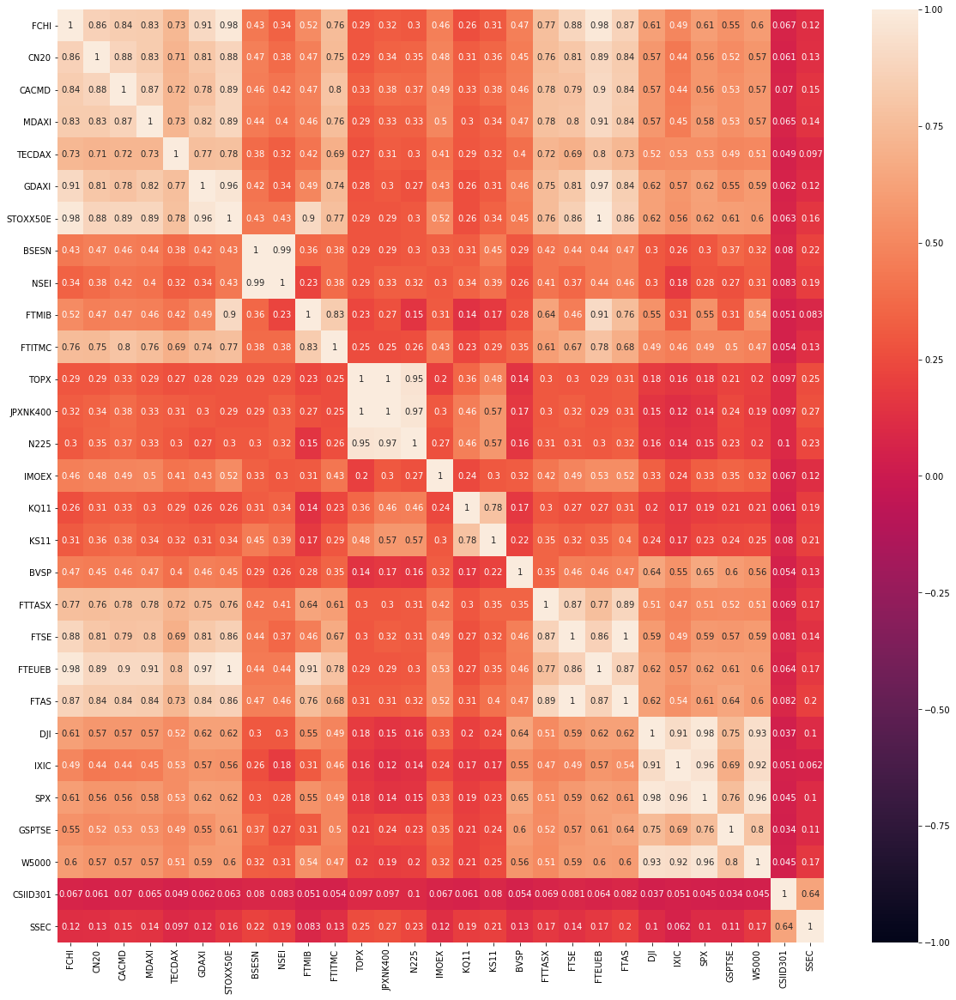

In [113]:
plt.subplots(figsize=(20,20))
heatmap = sns.heatmap(df_indices_close_returns_corr, vmin = -1, vmax = 1, annot = True).get_figure()
heatmap.savefig('indices_corr_heatmap.png')

In [77]:
df_indices_close_returns.head()

,FCHI,CN20,CACMD,MDAXI,TECDAX,GDAXI,STOXX50E,BSESN,NSEI,FTMIB,...,FTSE,FTEUEB,FTAS,DJI,IXIC,SPX,GSPTSE,W5000,CSIID301,SSEC
Date,,,,,,,,,,,,,,,,,,,,,
2000-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2000-01-04,-0.041463,-0.042091,-0.027925,-0.019029,-0.033704,NaN,NaN,NaN,0.029205,NaN,...,NaN,NaN,NaN,NaN,-0.055544,NaN,NaN,NaN,NaN,NaN
2000-01-05,-0.033907,-0.028626,-0.032705,-0.013322,-0.033630,NaN,NaN,NaN,-0.026179,NaN,...,NaN,NaN,NaN,NaN,-0.006190,NaN,-0.010141,NaN,NaN,0.002354
2000-01-06,-0.005400,-0.013048,0.006452,0.005327,-0.004270,NaN,NaN,NaN,0.013661,NaN,...,NaN,NaN,NaN,NaN,-0.038790,NaN,-0.000638,NaN,NaN,0.038491
2000-01-07,0.016422,0.033137,0.018194,0.019760,0.040638,NaN,NaN,NaN,-0.002658,NaN,...,NaN,NaN,NaN,NaN,0.041718,NaN,0.038843,NaN,NaN,0.035971


In [78]:
df_indices_close_melt = df_indices_close_returns.reset_index()
df_indices_close_melt = df_indices_close_melt.melt(id_vars = ['Date'], var_name = 'Index', value_name = 'Close')
df_indices_close_melt.sort_index(axis=0, level=None, ascending=True, inplace=False)
df_indices_close_melt.describe()

,Close
count,126409.000000
mean,0.000301
std,0.014482
min,-0.186631
25%,-0.005166
50%,0.000000
75%,0.006428
max,1.474352


In [79]:
top_indices.head()
top_indices_2 = top_indices.set_index('symbol')
top_indices_2.head()

df_indices_close_melt_2 = df_indices_close_melt.set_index('Index')
df_indices_close_melt_2.head()

,Date,Close
Index,,
FCHI,2000-01-03,NaN
FCHI,2000-01-04,-0.041463
FCHI,2000-01-05,-0.033907
FCHI,2000-01-06,-0.005400
FCHI,2000-01-07,0.016422


In [80]:
df_indices_close_returns_sum_melt = df_indices_close_returns_sum.reset_index()
df_indices_close_returns_sum_melt = df_indices_close_returns_sum_melt.melt(id_vars = ['Date'], var_name = 'Index', value_name = 'returns_sum')
df_indices_close_returns_sum_melt = df_indices_close_returns_sum_melt.sort_index(axis=0, level=None, ascending=True, inplace=False)
df_indices_close_returns_sum_melt = df_indices_close_returns_sum_melt.rename(columns = {'Index' : 'index'})
df_indices_close_returns_sum_melt = df_indices_close_returns_sum_melt.set_index(['Date', 'index']).dropna(subset = ['returns_sum'])
df_indices_close_returns_sum_melt = df_indices_close_returns_sum_melt.sort_values(by = ['Date', 'index'], ascending = (True, True))
df_indices_close_returns_sum_melt.describe()

,returns_sum
count,126409.000000
mean,1.859897
std,1.959670
min,0.060091
25%,0.922638
50%,1.354622
75%,1.959158
max,19.011676


In [81]:
df_index_close = top_indices_2.join(df_indices_close_melt_2, how = 'right')
df_index_close = df_index_close.reset_index().set_index(['Date', 'index']).dropna(subset = ['Close'])
df_index_close = df_index_close.sort_values(by = ['Date', 'index'], ascending = (True, True))
df_index_close.head()

country         name         full_name currency  \
Date       index                                                          
2000-01-04 CACMD         france   CAC Mid 60        CAC Mid 60      EUR   
           CN20          france  CAC Next 20       CAC Next 20      EUR   
           FCHI          france       CAC 40            CAC 40      EUR   
           IXIC   united states       Nasdaq  NASDAQ Composite      USD   
           MDAXI        germany       Midcap        DAX Midcap      EUR   

                               class         market     Close  
Date       index                                               
2000-01-04 CACMD  additional_indices  world_indices -0.027925  
           CN20   additional_indices  world_indices -0.042091  
           FCHI        major_indices  world_indices -0.041463  
           IXIC        major_indices  world_indices -0.055544  
           MDAXI  additional_indices  world_indices -0.019029

In [82]:
df_index_all = df_index_close.join(df_indices_close_returns_sum_melt, on = ['Date', 'index'])
df_index_all.describe()

,Close,returns_sum
count,126409.000000,126409.000000
mean,0.000301,1.859897
std,0.014482,1.959670
min,-0.186631,0.060091
25%,-0.005166,0.922638
50%,0.000000,1.354622
75%,0.006428,1.959158
max,1.474352,19.011676


In [83]:
df_index_all = df_index_all.reset_index().rename(columns = {'Date': 'date', 'Close': 'returns', 'index' : 'symbol'}).set_index(['date'])
df_index_all['asset_type'] = 'index'
df_index_all.head()

,symbol,country,name,full_name,currency,class,market,returns,returns_sum,asset_type
date,,,,,,,,,,
2000-01-04,CACMD,france,CAC Mid 60,CAC Mid 60,EUR,additional_indices,world_indices,-0.027925,0.972075,index
2000-01-04,CN20,france,CAC Next 20,CAC Next 20,EUR,additional_indices,world_indices,-0.042091,0.957909,index
2000-01-04,FCHI,france,CAC 40,CAC 40,EUR,major_indices,world_indices,-0.041463,0.958537,index
2000-01-04,IXIC,united states,Nasdaq,NASDAQ Composite,USD,major_indices,world_indices,-0.055544,0.944456,index
2000-01-04,MDAXI,germany,Midcap,DAX Midcap,EUR,additional_indices,world_indices,-0.019029,0.980971,index


In [84]:
#Crypto

coinbase_historical_data_filepath = Path("../data/CoinMarketCap_18JAN2020-close.csv")
crypto_data = pd.read_csv(coinbase_historical_data_filepath)
crypto_data["Date"] = pd.to_datetime(crypto_data["Date"])
crypto_data = crypto_data.rename(columns = {'Date': 'date'})
crypto_data = crypto_data.set_index(['date']).sort_index()
crypto_data.head()


,Bitcoin-BTC,Ethereum-ETH,Bitcoin-BSV,Litecoin-LTC,Monero-XMR,Dash-DASH,Kusama-KSM,Zcash-ZEC,Bitcoin Cash-BCH,Counos-CCXX
date,,,,,,,,,,
2013-04-28,144.54,NaN,NaN,4.38,NaN,NaN,NaN,NaN,NaN,NaN
2013-04-29,139.00,NaN,NaN,4.30,NaN,NaN,NaN,NaN,NaN,NaN
2013-04-30,116.99,NaN,NaN,3.80,NaN,NaN,NaN,NaN,NaN,NaN
2013-05-01,105.21,NaN,NaN,3.37,NaN,NaN,NaN,NaN,NaN,NaN
2013-05-02,97.75,NaN,NaN,3.04,NaN,NaN,NaN,NaN,NaN,NaN


In [85]:
crypto_returns = crypto_data.pct_change()
crypto_returns.describe()

,Bitcoin-BTC,Ethereum-ETH,Bitcoin-BSV,Litecoin-LTC,Monero-XMR,Dash-DASH,Kusama-KSM,Zcash-ZEC,Bitcoin Cash-BCH,Counos-CCXX
count,2804.000000,1973.000000,783.000000,2804.000000,2416.000000,2512.000000,384.000000,1523.000000,1256.000000,254.000000
mean,0.002790,0.005405,0.004618,0.003269,0.004024,0.005252,0.014072,0.001324,0.002536,0.007841
std,0.042210,0.062685,0.096960,0.068340,0.069320,0.089842,0.096691,0.082160,0.075627,0.068797
min,-0.371695,-0.423462,-0.463989,-0.401857,-0.389946,-0.373441,-0.304545,-0.362249,-0.429589,-0.459503
25%,-0.012136,-0.022436,-0.023320,-0.020548,-0.027831,-0.025488,-0.039234,-0.031164,-0.027838,-0.001470
50%,0.001896,0.000178,-0.001757,0.000000,0.000000,-0.001419,0.000000,-0.003300,-0.002545,0.000264
75%,0.018267,0.028371,0.020974,0.020540,0.032831,0.025966,0.052282,0.029019,0.026037,0.002948
max,0.429680,0.510446,1.424941,1.290954,0.794340,2.562654,0.590750,1.826241,0.539691,0.849513


In [86]:
crypto_returns_sum = (1 + crypto_returns).cumprod()
crypto_returns_sum.describe()

,Bitcoin-BTC,Ethereum-ETH,Bitcoin-BSV,Litecoin-LTC,Monero-XMR,Dash-DASH,Kusama-KSM,Zcash-ZEC,Bitcoin Cash-BCH,Counos-CCXX
count,2804.000000,1973.000000,783.000000,2804.000000,2416.000000,2512.000000,384.000000,1523.000000,1256.000000,254.000000
mean,28.589035,297.094868,1.696785,9.006871,28.857308,359.390514,9.493333,0.235430,1.181081,1.764711
std,32.730368,307.765302,0.727044,11.394378,36.435141,595.229324,10.134599,0.240595,1.150858,1.194686
min,0.473433,0.577194,0.491041,0.264840,0.106429,1.292474,0.582857,0.042622,0.175562,0.968106
25%,2.891639,16.792778,1.039685,0.849315,0.594048,13.337567,1.462857,0.089698,0.534417,1.001472
50%,7.473641,240.050445,1.786125,4.737443,22.030952,216.465545,3.905714,0.122264,0.714364,1.003435
75%,52.300073,406.836586,2.160234,13.082192,42.623810,389.925373,18.151429,0.335261,1.273514,2.315751
max,203.225059,1853.736891,4.855732,81.812785,223.428571,4924.896793,41.120000,2.826241,8.901906,4.371933


In [87]:
crypto_returns_melt = crypto_returns.reset_index().melt(id_vars = ['date'], var_name = 'symbol', value_name = 'returns').set_index(['date', 'symbol']).dropna(subset = ['returns']).drop_duplicates()
crypto_returns_melt['asset_type'] = 'crypto'
crypto_returns_melt = crypto_returns_melt.reset_index().set_index(['date', 'symbol', 'asset_type'])
crypto_returns_melt.head()

crypto_returns_sum_melt = crypto_returns_sum.reset_index().melt(id_vars = ['date'], var_name = 'symbol', value_name = 'returns_sum').set_index(['date', 'symbol']).dropna(subset = ['returns_sum']).drop_duplicates()
crypto_returns_sum_melt['asset_type'] = 'crypto'
crypto_returns_sum_melt = crypto_returns_sum_melt.reset_index().set_index(['date', 'symbol', 'asset_type'])

crypto_returns_sum_melt

,,,returns_sum
date,symbol,asset_type,
2013-04-29,Bitcoin-BTC,crypto,0.961672
2013-04-30,Bitcoin-BTC,crypto,0.809395
2013-05-01,Bitcoin-BTC,crypto,0.727895
2013-05-02,Bitcoin-BTC,crypto,0.676283
2013-05-03,Bitcoin-BTC,crypto,0.778331
...,...,...,...
2020-12-27,Counos-CCXX,crypto,4.277723
2020-12-28,Counos-CCXX,crypto,4.288027
2020-12-29,Counos-CCXX,crypto,4.301766


In [88]:
#Join Indices and Crypto
df_index_all = df_index_all.reset_index().set_index(['date', 'symbol', 'asset_type'])
df_index_all = pd.concat([df_index_all, crypto_returns_melt, crypto_returns_sum_melt], 
    axis=0,
    join="outer",
    ignore_index=False,
    keys=None,
    levels=None,
    names=None,
    verify_integrity=False,
    copy=True,)
df_index_all.describe()
df_index_all = df_index_all.reset_index().set_index(['date'])

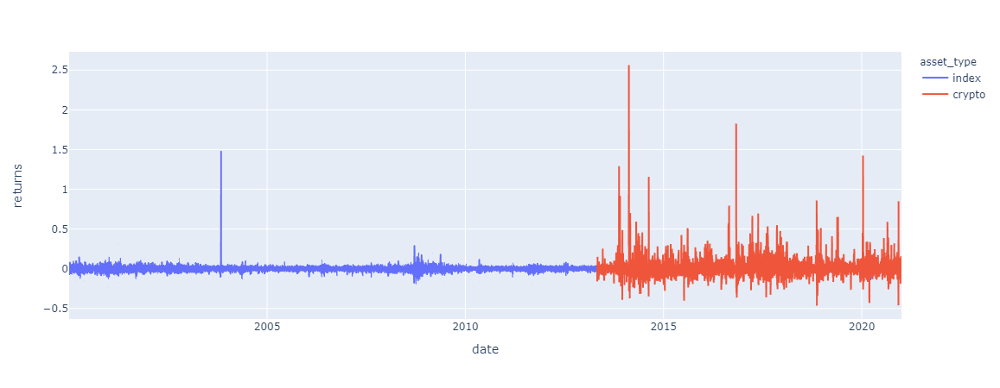

In [89]:
df_index_close_fig = px.line(df_index_all, x=df_index_all.index , y = 'returns', line_group = 'symbol', color = 'asset_type')
df_index_close_fig.show()

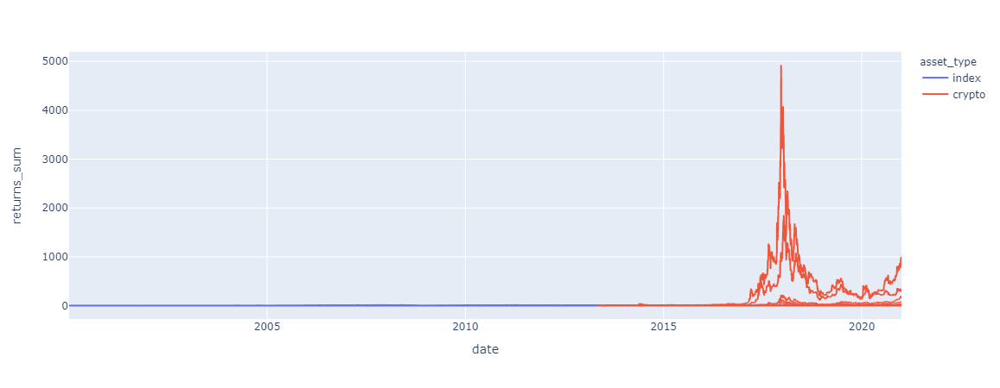

In [90]:
df_index_close_fig = px.line(df_index_all, x=df_index_all.index , y = 'returns_sum', line_group = 'symbol', color = 'asset_type')
df_index_close_fig.show()

In [101]:
df_all_returns = pd.concat([crypto_returns, df_indices_close_returns], axis = 1, join = 'outer')
df_all_returns.head()

,Bitcoin-BTC,Ethereum-ETH,Bitcoin-BSV,Litecoin-LTC,Monero-XMR,Dash-DASH,Kusama-KSM,Zcash-ZEC,Bitcoin Cash-BCH,Counos-CCXX,...,FTSE,FTEUEB,FTAS,DJI,IXIC,SPX,GSPTSE,W5000,CSIID301,SSEC
2000-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2000-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,-0.055544,NaN,NaN,NaN,NaN,NaN
2000-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,-0.006190,NaN,-0.010141,NaN,NaN,0.002354
2000-01-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,-0.038790,NaN,-0.000638,NaN,NaN,0.038491
2000-01-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0.041718,NaN,0.038843,NaN,NaN,0.035971


In [105]:
df_returns_all_corr = df_all_returns.corr()
df_returns_all_corr.head()

,Bitcoin-BTC,Ethereum-ETH,Bitcoin-BSV,Litecoin-LTC,Monero-XMR,Dash-DASH,Kusama-KSM,Zcash-ZEC,Bitcoin Cash-BCH,Counos-CCXX,...,FTSE,FTEUEB,FTAS,DJI,IXIC,SPX,GSPTSE,W5000,CSIID301,SSEC
Bitcoin-BTC,1.000000,0.487632,0.439218,0.650036,0.477130,0.358706,-0.027433,0.004354,-0.091343,-0.039298,...,-0.026375,-0.030962,-0.027209,-0.024853,-0.030316,-0.028790,-0.046625,-0.037415,-0.025680,0.010824
Ethereum-ETH,0.487632,1.000000,0.456955,0.464454,0.424045,0.441629,-0.064962,0.001799,-0.049279,-0.072453,...,-0.014888,-0.018509,-0.012822,-0.024837,-0.036015,-0.029059,-0.022601,-0.031457,-0.026160,0.016152
Bitcoin-BSV,0.439218,0.456955,1.000000,0.459281,0.399130,0.429294,-0.030739,0.004900,-0.077793,-0.093785,...,-0.040515,-0.076285,-0.041755,-0.046333,-0.045804,-0.047102,-0.049575,-0.062322,NaN,0.058672
Litecoin-LTC,0.650036,0.464454,0.459281,1.000000,0.395979,0.314803,-0.085277,0.018064,-0.044606,-0.035745,...,-0.036283,-0.036832,-0.035947,-0.027955,-0.036163,-0.033806,-0.037841,-0.040144,-0.043406,-0.016183
Monero-XMR,0.477130,0.424045,0.399130,0.395979,1.000000,0.379525,-0.107951,-0.030087,-0.052368,-0.082054,...,-0.018041,-0.015290,-0.018375,-0.016847,-0.023220,-0.019532,-0.026366,-0.021868,-0.029552,-0.008319


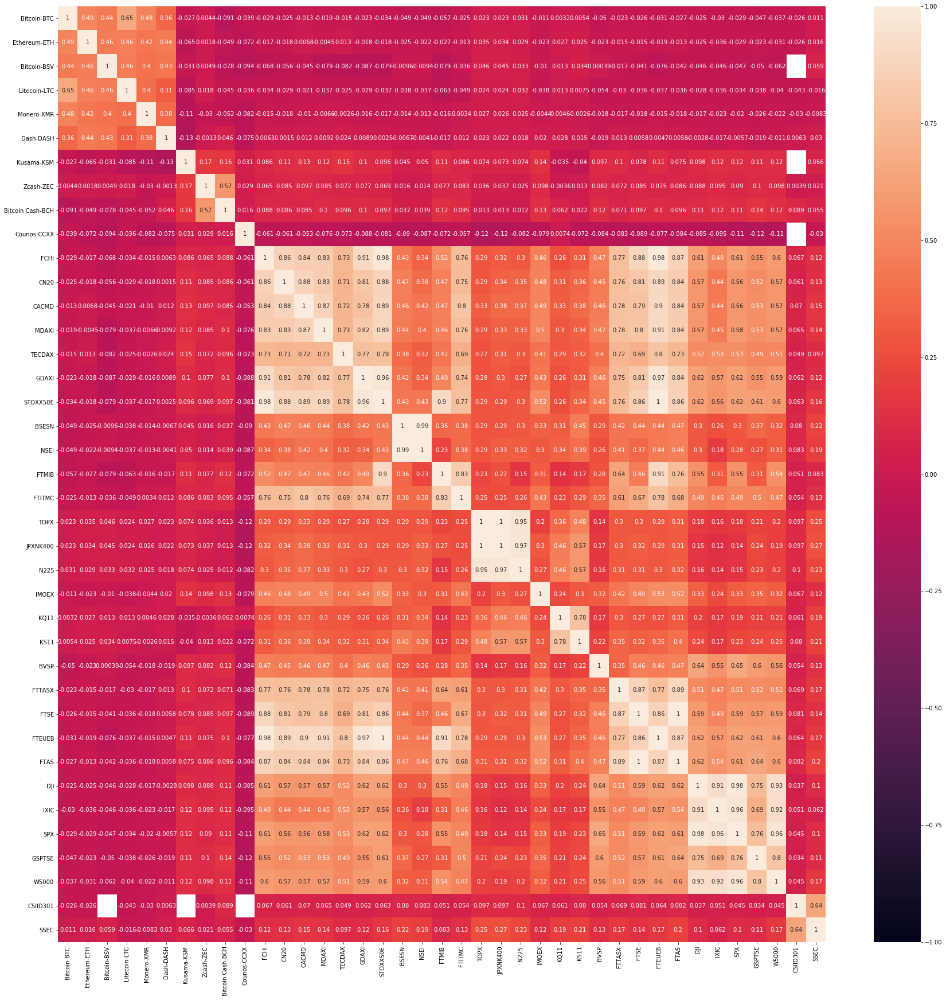

In [112]:
plt.subplots(figsize=(30,30))
heatmap_indices_crypto = sns.heatmap(df_returns_all_corr, vmin = -1, vmax = 1, annot = True).get_figure()
heatmap_indices_crypto.savefig("indices_crypto_corr_plot.png")

In [92]:
#Calculate Stanard Deviation
daily_std = df_all_returns.std().sort_values(ascending = True)
daily_std.describe()

#Calculate Annualized Standard Deviation
annualized_std = daily_std * np.sqrt(252)
annualized_std.describe()

count    39.000000
mean      0.466886
std       0.454620
min       0.139374
25%       0.193263
50%       0.226422
75%       0.542352
max       1.539193
dtype: float64

In [93]:
# Calculate sharpe ratio
sharpe_ratios = (df_all_returns.mean() * 252) / (annualized_std * np.sqrt(252))
sharpe_ratios = sharpe_ratios.sort_values(ascending = False)
sharpe_ratios.head()

Kusama-KSM      0.145541
Counos-CCXX     0.113976
Ethereum-ETH    0.086226
Bitcoin-BTC     0.066088
Dash-DASH       0.058457
dtype: float64

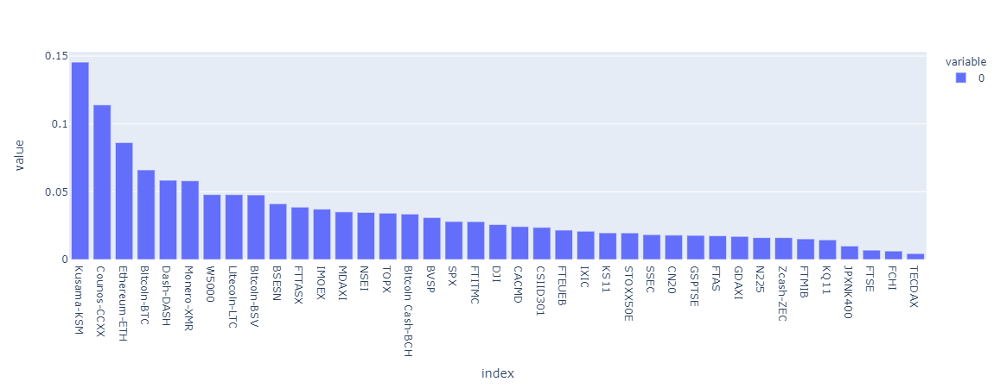

In [94]:
sharpe_fig = px.bar(sharpe_ratios)
sharpe_fig.show()

In [95]:
# Calculate covariance of all daily returns of indices and cryptos
df_covariance = df_all_returns.cov().reset_index().rename(columns = {'index': 'symbol'})
df_covariance.head()

,symbol,Bitcoin-BTC,Ethereum-ETH,Bitcoin-BSV,Litecoin-LTC,Monero-XMR,Dash-DASH,Kusama-KSM,Zcash-ZEC,Bitcoin Cash-BCH,...,FTSE,FTEUEB,FTAS,DJI,IXIC,SPX,GSPTSE,W5000,CSIID301,SSEC
0,Bitcoin-BTC,0.001782,0.001187,0.001610,0.001875,0.001253,0.001241,-0.000099,0.000015,-0.000287,...,-0.000011,-0.000015,-0.000011,-0.000012,-0.000015,-0.000013,-0.000019,-0.000017,-0.000014,0.000006
1,Ethereum-ETH,0.001187,0.003929,0.002101,0.001652,0.001735,0.001631,-0.000307,0.000008,-0.000189,...,-0.000010,-0.000014,-0.000009,-0.000020,-0.000030,-0.000022,-0.000015,-0.000024,-0.000017,0.000013
2,Bitcoin-BSV,0.001610,0.002101,0.009401,0.002264,0.001799,0.002249,-0.000283,0.000025,-0.000455,...,-0.000058,-0.000115,-0.000058,-0.000082,-0.000082,-0.000079,-0.000075,-0.000104,0.000000,0.000072
3,Litecoin-LTC,0.001875,0.001652,0.002264,0.004670,0.001577,0.001639,-0.000417,0.000092,-0.000196,...,-0.000025,-0.000029,-0.000023,-0.000021,-0.000029,-0.000024,-0.000024,-0.000029,-0.000038,-0.000015
4,Monero-XMR,0.001253,0.001735,0.001799,0.001577,0.004805,0.001762,-0.000480,-0.000148,-0.000226,...,-0.000013,-0.000012,-0.000013,-0.000013,-0.000020,-0.000015,-0.000018,-0.000016,-0.000026,-0.000008


In [96]:
df_covariance_SPX = df_covariance[df_covariance['symbol'].str.contains('SPX')].set_index('symbol')
df_covariance_SPX = df_covariance_SPX.melt(var_name = 'symbol', value_name = 'covariance').sort_values('covariance', ascending = False)
df_covariance_SPX.head() 

,symbol,covariance
6,Kusama-KSM,0.000254
33,IXIC,0.000159
34,SPX,0.000154
32,DJI,0.000152
27,BVSP,0.000140


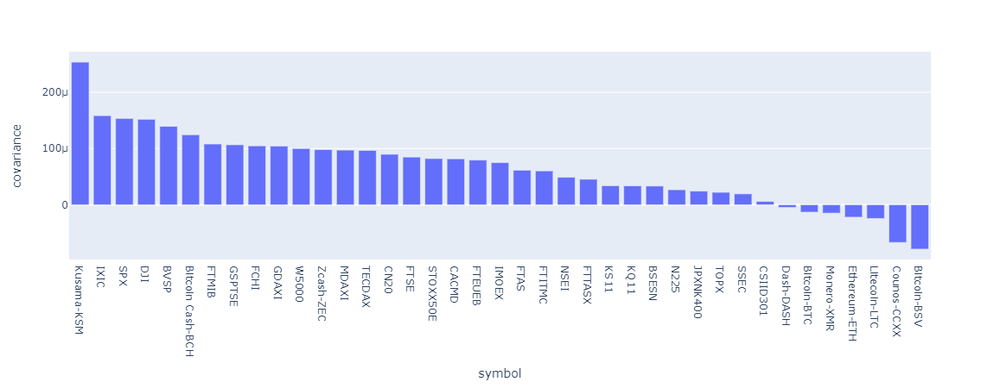

In [97]:
covariance_fig = px.bar(df_covariance_SPX, x = 'symbol', y = 'covariance')
covariance_fig.show()

In [98]:
#S&P 500 Variance
SPX_var = df_all_returns['SPX'].var()

SPX_beta = df_covariance_SPX
SPX_beta['variance'] = SPX_var
SPX_beta['beta'] = SPX_beta['covariance'] / SPX_beta['variance']
SPX_beta = SPX_beta.sort_values('beta', ascending = False)
SPX_beta.head()

,symbol,covariance,variance,beta
6,Kusama-KSM,0.000254,0.000154,1.651757
33,IXIC,0.000159,0.000154,1.032381
34,SPX,0.000154,0.000154,1.000000
32,DJI,0.000152,0.000154,0.990245
27,BVSP,0.000140,0.000154,0.908573


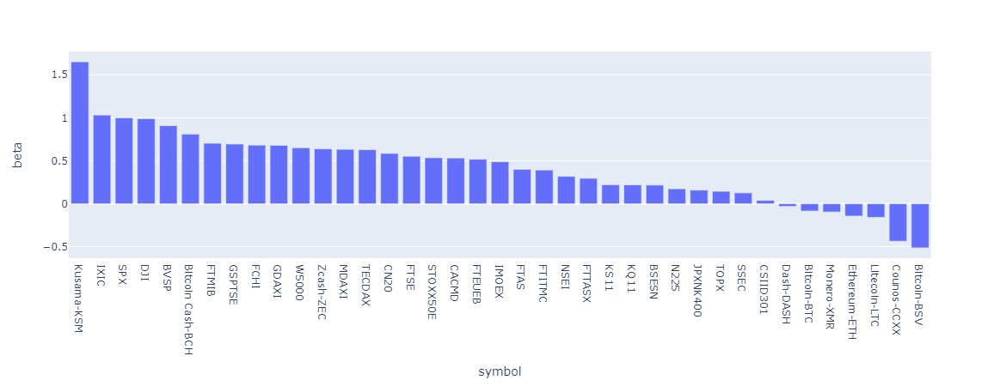

In [99]:
SPX_beta_fig = px.bar(SPX_beta, x = 'symbol', y = 'beta')
SPX_beta_fig.show()